
# Prepare data for classification

Use two trained networks to predict os/cervix masks, merge results to create a final os/cervix mask for all train/test data.




In [2]:
# https://ipython.org/ipython-doc/3/config/extensions/autoreload.html
%load_ext autoreload
%autoreload 2

In [3]:
import os
import sys
from datetime import datetime
from glob import glob
    
# Project
project_common_path = os.path.abspath(os.path.join('..', 'common'))
if not project_common_path in sys.path:
    sys.path.append(project_common_path)    

from data_utils import type_1_ids, type_2_ids, type_3_ids, test_ids
from data_utils import RESOURCES_PATH, GENERATED_DATA, get_annotations

from image_utils import get_image_data
from image_utils import imwrite

import matplotlib.pylab as plt
%matplotlib inline
        

def plt_st(n, m):
    plt.figure(figsize=(n, m))

type_ids = [type_1_ids, type_2_ids, type_3_ids, test_ids]
image_types = ["Type_1", "Type_2", "Type_3", "Test"]
all_trainval_id_type_list = []
for ids, image_type in zip(type_ids, image_types):
    for image_id in ids:
        all_trainval_id_type_list.append((image_id, image_type))
        
print("Length of all_trainval_id_type_list:", len(all_trainval_id_type_list))

/usr/local/lib/python2.7/site-packages/matplotlib/font_manager.py:273: UserWarning: Matplotlib is building the font cache using fc-list. This may take a moment.
  warnings.warn('Matplotlib is building the font cache using fc-list. This may take a moment.')


('Length of all_trainval_id_type_list:', 1993)


In [ ]:
from unet_keras_v1 import get_unet
from xy_providers import image_provider
from preprocessing.image.iterators import ImageMaskIterator


print("\n {} - Get U-Net model ...".format(datetime.now()))
unet = get_unet(input_shape=(3, 224, 224), n_classes=2)

In [4]:
## Load first model:
save_prefix='unet_os_cervix_detector_seed=2017'

weights_files = glob("weights/%s*.h5" % save_prefix)
best_val_loss = 1e5
best_weights_filename = ""
for f in weights_files:
    index = os.path.basename(f).index('-')
    loss = float(os.path.basename(f)[index+1:-4])
    if best_val_loss > loss:
        best_val_loss = loss
        best_weights_filename = f
print("Best val loss weights: ", best_weights_filename)


if len(best_weights_filename) > 0:
    # load weights to the model
    print("Load found weights: ", best_weights_filename)
    unet.load_weights(best_weights_filename)

('Best val loss weights: ', 'weights/unet_os_cervix_detector_seed=2017_42-0.3980.h5')
('Load found weights: ', 'weights/unet_os_cervix_detector_seed=2017_42-0.3980.h5')


In [5]:
batch_size = 4
all_trainval_iter = ImageMaskIterator(image_provider(all_trainval_id_type_list), 
                                      len(all_trainval_id_type_list), 
                                      None, # image generator
                                      batch_size=batch_size,
                                      data_format='channels_first')
counter = 1
ll = len(all_trainval_id_type_list)
for x, _, info in all_trainval_iter:               
    y_pred = unet.predict(x)   
    for i in range(y_pred.shape[0]):
        print('-- %i / %i : %s, %s' % (counter, ll, info[i][0], info[i][1]))        
        image_id = info[i][0] + '_' + info[i][1]
        imwrite(y_pred[i, :, :, :].transpose([1, 2, 0]), image_id, 'os_cervix_label_1')
        counter += 1

-- 1 / 1993 : 0, Type_1
-- 2 / 1993 : 10, Type_1
-- 3 / 1993 : 1013, Type_1
-- 4 / 1993 : 1014, Type_1
-- 5 / 1993 : 1019, Type_1
-- 6 / 1993 : 102, Type_1
-- 7 / 1993 : 1023, Type_1
-- 8 / 1993 : 1024, Type_1
-- 9 / 1993 : 1026, Type_1
-- 10 / 1993 : 1027, Type_1
-- 11 / 1993 : 1033, Type_1
-- 12 / 1993 : 104, Type_1
-- 13 / 1993 : 1040, Type_1
-- 14 / 1993 : 1056, Type_1
-- 15 / 1993 : 1059, Type_1
-- 16 / 1993 : 1061, Type_1
-- 17 / 1993 : 1070, Type_1
-- 18 / 1993 : 1071, Type_1
-- 19 / 1993 : 1077, Type_1
-- 20 / 1993 : 1079, Type_1
-- 21 / 1993 : 109, Type_1
-- 22 / 1993 : 1093, Type_1
-- 23 / 1993 : 1100, Type_1
-- 24 / 1993 : 1105, Type_1
-- 25 / 1993 : 1123, Type_1
-- 26 / 1993 : 1131, Type_1
-- 27 / 1993 : 1134, Type_1
-- 28 / 1993 : 1136, Type_1
-- 29 / 1993 : 1139, Type_1
-- 30 / 1993 : 1154, Type_1
-- 31 / 1993 : 1161, Type_1
-- 32 / 1993 : 1168, Type_1
-- 33 / 1993 : 1174, Type_1
-- 34 / 1993 : 1179, Type_1
-- 35 / 1993 : 1190, Type_1
-- 36 / 1993 : 1194, Type_1
-- 37 / 1

In [7]:
## Load second model:
lr_2 = 1e-2; a_2 = 0.875
save_prefix='unet_os_cervix_detector_seed=54321_lr=%.3f_a=%.3f' % (lr_2, a_2)

weights_files = glob("weights/%s*.h5" % save_prefix)
best_val_loss = 1e5
best_weights_filename = ""
for f in weights_files:
    index = os.path.basename(f).index('-')
    loss = float(os.path.basename(f)[index+1:-4])
    if best_val_loss > loss:
        best_val_loss = loss
        best_weights_filename = f
print("Best val loss weights: ", best_weights_filename)


if len(best_weights_filename) > 0:
    # load weights to the model
    print("Load found weights: ", best_weights_filename)
    unet.load_weights(best_weights_filename)    

('Best val loss weights: ', 'weights/unet_os_cervix_detector_seed=54321_lr=0.010_a=0.875_09-0.3902.h5')
('Load found weights: ', 'weights/unet_os_cervix_detector_seed=54321_lr=0.010_a=0.875_09-0.3902.h5')


In [8]:
batch_size = 4
all_trainval_iter = ImageMaskIterator(image_provider(all_trainval_id_type_list), 
                                      len(all_trainval_id_type_list), 
                                      None, # image generator
                                      batch_size=batch_size,
                                      data_format='channels_first')
counter = 1
ll = len(all_trainval_id_type_list)
for x, _, info in all_trainval_iter:               
    y_pred = unet.predict(x)   
    for i in range(y_pred.shape[0]):
        print('-- %i / %i : %s, %s' % (counter, ll, info[i][0], info[i][1]))        
        image_id = info[i][0] + '_' + info[i][1]
        imwrite(y_pred[i, :, :, :].transpose([1, 2, 0]), image_id, 'os_cervix_label_2')
        counter += 1

-- 1 / 1993 : 0, Type_1
-- 2 / 1993 : 10, Type_1
-- 3 / 1993 : 1013, Type_1
-- 4 / 1993 : 1014, Type_1
-- 5 / 1993 : 1019, Type_1
-- 6 / 1993 : 102, Type_1
-- 7 / 1993 : 1023, Type_1
-- 8 / 1993 : 1024, Type_1
-- 9 / 1993 : 1026, Type_1
-- 10 / 1993 : 1027, Type_1
-- 11 / 1993 : 1033, Type_1
-- 12 / 1993 : 104, Type_1
-- 13 / 1993 : 1040, Type_1
-- 14 / 1993 : 1056, Type_1
-- 15 / 1993 : 1059, Type_1
-- 16 / 1993 : 1061, Type_1
-- 17 / 1993 : 1070, Type_1
-- 18 / 1993 : 1071, Type_1
-- 19 / 1993 : 1077, Type_1
-- 20 / 1993 : 1079, Type_1
-- 21 / 1993 : 109, Type_1
-- 22 / 1993 : 1093, Type_1
-- 23 / 1993 : 1100, Type_1
-- 24 / 1993 : 1105, Type_1
-- 25 / 1993 : 1123, Type_1
-- 26 / 1993 : 1131, Type_1
-- 27 / 1993 : 1134, Type_1
-- 28 / 1993 : 1136, Type_1
-- 29 / 1993 : 1139, Type_1
-- 30 / 1993 : 1154, Type_1
-- 31 / 1993 : 1161, Type_1
-- 32 / 1993 : 1168, Type_1
-- 33 / 1993 : 1174, Type_1
-- 34 / 1993 : 1179, Type_1
-- 35 / 1993 : 1190, Type_1
-- 36 / 1993 : 1194, Type_1
-- 37 / 1

### Display some of computed labels

('os cervix mask 1 : ', 1631, 12997)
('os cervix mask 2 : ', 1923, 16690)
('os_index: ', 0.082160945411306668)
('cervix_index: ', 0.12439788459595109)
('os cervix mask 1 : ', 421, 7223)
('os cervix mask 2 : ', 929, 7263)
('os_index: ', 0.37629629626842248)
('cervix_index: ', 0.0027612867596299878)
('os cervix mask 1 : ', 0, 147)
('os cervix mask 2 : ', 588, 6071)
('os_index: ', 0.99999999982993204)
('cervix_index: ', 0.95271791572853004)
('os cervix mask 1 : ', 5, 1935)
('os cervix mask 2 : ', 0, 3416)
('os_index: ', 0.99999998000000034)
('cervix_index: ', 0.27677069706596896)
('os cervix mask 1 : ', 269, 533)
('os cervix mask 2 : ', 475, 8668)
('os_index: ', 0.27688172039289227)
('cervix_index: ', 0.88414302793174659)
('os cervix mask 1 : ', 0, 0)
('os cervix mask 2 : ', 34, 5301)
('os_index: ', 0.99999999705882348)
('cervix_index: ', 1.0)
('os cervix mask 1 : ', 2301, 10059)
('os cervix mask 2 : ', 3083, 21424)
('os_index: ', 0.1452451708739739)
('cervix_index: ', 0.36098846996791917

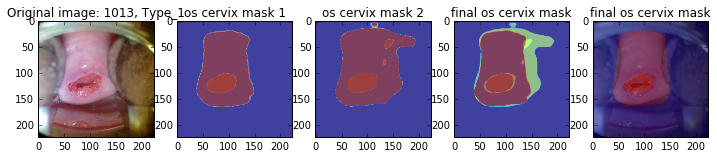

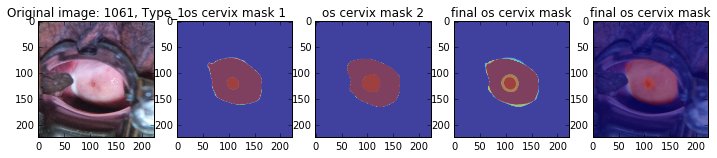

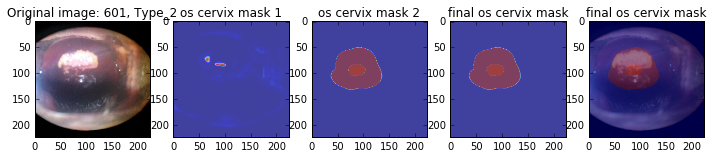

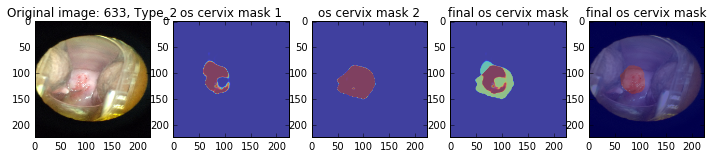

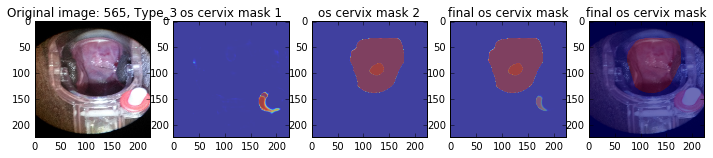

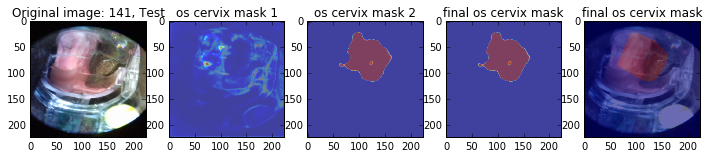

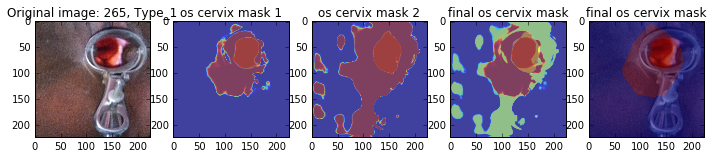

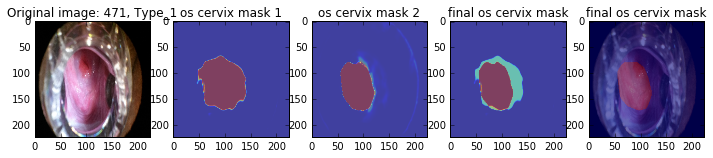

In [55]:
import cv2
import numpy as np
from postprocessing_utils import os_cervix_postproc

id_type_list = [('1013', 'Type_1'), 
                ('1061', 'Type_1'), 
                ('601', 'Type_2'), 
                ('633', 'Type_2'), 
                ('565', 'Type_3'), 
                ('141', 'Test'),
                ('265', 'Type_1'),                
                ('471', 'Type_1')]

def _resize(mask, size):
    mask = cv2.resize(mask, dsize=size, interpolation=cv2.INTER_NEAREST)
    return mask


def merge_masks(os_cervix_mask_1, os_cervix_mask_2):
    os_cervix_1_sum = np.sum(os_cervix_mask_1 > 0.5, axis=(0, 1))
    os_cervix_2_sum = np.sum(os_cervix_mask_2 > 0.5, axis=(0, 1))
    os_cervix_indices = np.abs(os_cervix_1_sum - os_cervix_2_sum) * 1.0 / (os_cervix_1_sum + os_cervix_2_sum + 1e-7)    
    
    final_os_cervix_mask = np.zeros_like(os_cervix_mask_1)    
    for i in range(2):
        if os_cervix_indices[i] < 0.5:
            final_os_cervix_mask[:,:,i] = 0.45 * os_cervix_mask_1[:,:,i] + 0.55 * os_cervix_mask_2[:,:,i]
        else:
            if os_cervix_1_sum[i] > os_cervix_2_sum[i]:
                final_os_cervix_mask[:,:,i] = os_cervix_mask_1[:,:,i]
            else:
                final_os_cervix_mask[:,:,i] = os_cervix_mask_2[:,:,i]
    return final_os_cervix_mask
    

for image_id, image_type in id_type_list:

    img = get_image_data(image_id, image_type)
    os_cervix_mask_1 = get_image_data(image_id + "_" + image_type, 'os_cervix_label_1')
    os_cervix_mask_2 = get_image_data(image_id + "_" + image_type, 'os_cervix_label_2')
    img = _resize(img, os_cervix_mask_1.shape[:2][::-1])
        
    print("os cervix mask 1 : ", np.sum(os_cervix_mask_1[:,:,0] > 0.5), np.sum(os_cervix_mask_1[:,:,1] > 0.5))    
    print("os cervix mask 2 : ", np.sum(os_cervix_mask_2[:,:,0] > 0.5), np.sum(os_cervix_mask_2[:,:,1] > 0.5))    
    
    os_1 = np.sum(os_cervix_mask_1[:,:,0] > 0.5)
    os_2 = np.sum(os_cervix_mask_2[:,:,0] > 0.5)
    os_min = min(os_1, os_2)
    cervix_1 = np.sum(os_cervix_mask_1[:,:,1] > 0.5)
    cervix_2 = np.sum(os_cervix_mask_2[:,:,1] > 0.5)

    os_index = np.abs(os_1 - os_2) * 1.0/(os_1 + os_2 + 1e-7)    
    print("os_index: ", os_index)    
    cervix_index = np.abs(cervix_1 - cervix_2) * 1.0 /(cervix_1 + cervix_2)    
    print("cervix_index: ", cervix_index)
        
    final_os_cervix_mask = merge_masks(os_cervix_mask_1, os_cervix_mask_2)
    final_os_cervix_mask_2 = os_cervix_postproc(final_os_cervix_mask)
    
    plt_st(12, 6)
    plt.subplot(151)
    plt.imshow(img)
    plt.title("Original image: %s, %s" % (image_id, image_type))
    plt.subplot(152)
    plt.imshow(os_cervix_mask_1[:,:,0], alpha=0.5, cmap='jet')    
    plt.imshow(os_cervix_mask_1[:,:,1], alpha=0.5, cmap='jet')
    plt.title("os cervix mask 1")
    plt.subplot(153)
    plt.imshow(os_cervix_mask_2[:,:,0], alpha=0.5, cmap='jet')
    plt.imshow(os_cervix_mask_2[:,:,1], alpha=0.5, cmap='jet')
    plt.title("os cervix mask 2")        
    plt.subplot(154)
    plt.imshow(final_os_cervix_mask[:,:,0], alpha=0.5, cmap='jet')
    plt.imshow(final_os_cervix_mask[:,:,1], alpha=0.5, cmap='jet')
    plt.title("final os cervix mask")        
    plt.subplot(155)
    plt.imshow(img)
    plt.imshow(final_os_cervix_mask_2[:,:,0], alpha=0.35, cmap='jet')
    plt.imshow(final_os_cervix_mask_2[:,:,1], alpha=0.35, cmap='jet')
    plt.title("final os cervix mask")        

## Create final os/cervix mask 

In [56]:
# Remove corrupted training image
all_trainval_id_type_list.remove(('1339', 'Type_1'))

ValueError: list.remove(x): x not in list

In [57]:
from postprocessing_utils import os_cervix_postproc

counter = 1
ll = len(all_trainval_id_type_list)
for image_id, image_type in all_trainval_id_type_list:
    os_cervix_mask_1 = get_image_data(image_id + "_" + image_type, 'os_cervix_label_1')
    os_cervix_mask_2 = get_image_data(image_id + "_" + image_type, 'os_cervix_label_2')    
    final_os_cervix_mask = merge_masks(os_cervix_mask_1, os_cervix_mask_2)    
    final_os_cervix_mask = os_cervix_postproc(final_os_cervix_mask)
    print('-- %i / %i : %s, %s' % (counter, ll, image_id, image_type))   
    imwrite(final_os_cervix_mask, image_id + '_' + image_type, 'os_cervix_label')
    counter += 1

-- 1 / 1992 : 0, Type_1
-- 2 / 1992 : 10, Type_1
-- 3 / 1992 : 1013, Type_1
-- 4 / 1992 : 1014, Type_1
-- 5 / 1992 : 1019, Type_1
-- 6 / 1992 : 102, Type_1
-- 7 / 1992 : 1023, Type_1
-- 8 / 1992 : 1024, Type_1
-- 9 / 1992 : 1026, Type_1
-- 10 / 1992 : 1027, Type_1
-- 11 / 1992 : 1033, Type_1
-- 12 / 1992 : 104, Type_1
-- 13 / 1992 : 1040, Type_1
-- 14 / 1992 : 1056, Type_1
-- 15 / 1992 : 1059, Type_1
-- 16 / 1992 : 1061, Type_1
-- 17 / 1992 : 1070, Type_1
-- 18 / 1992 : 1071, Type_1
-- 19 / 1992 : 1077, Type_1
-- 20 / 1992 : 1079, Type_1
-- 21 / 1992 : 109, Type_1
-- 22 / 1992 : 1093, Type_1
-- 23 / 1992 : 1100, Type_1
-- 24 / 1992 : 1105, Type_1
-- 25 / 1992 : 1123, Type_1
-- 26 / 1992 : 1131, Type_1
-- 27 / 1992 : 1134, Type_1
-- 28 / 1992 : 1136, Type_1
-- 29 / 1992 : 1139, Type_1
-- 30 / 1992 : 1154, Type_1
-- 31 / 1992 : 1161, Type_1
-- 32 / 1992 : 1168, Type_1
-- 33 / 1992 : 1174, Type_1
-- 34 / 1992 : 1179, Type_1
-- 35 / 1992 : 1190, Type_1
-- 36 / 1992 : 1194, Type_1
-- 37 / 1

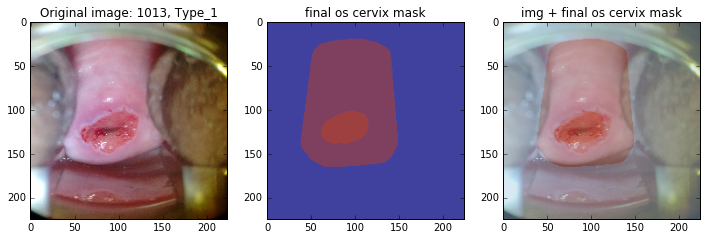

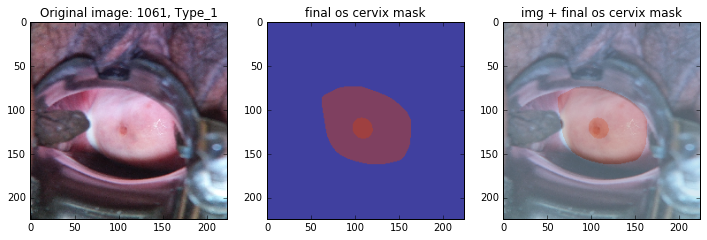

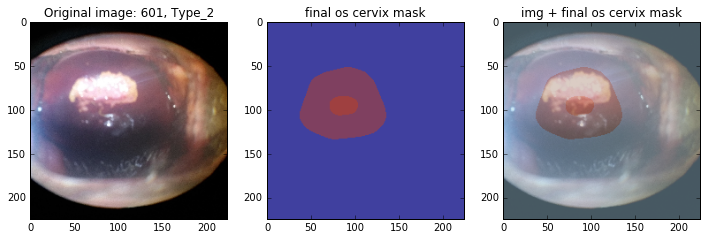

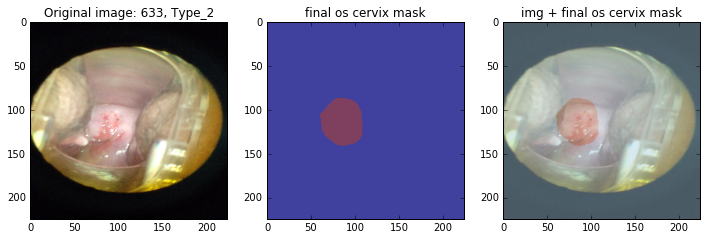

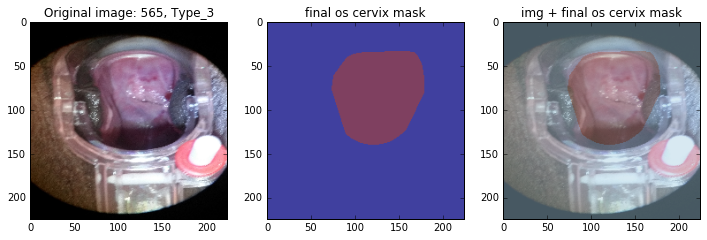

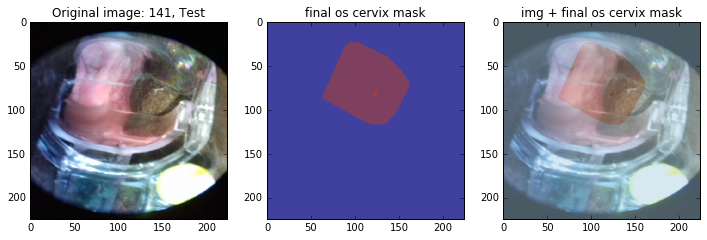

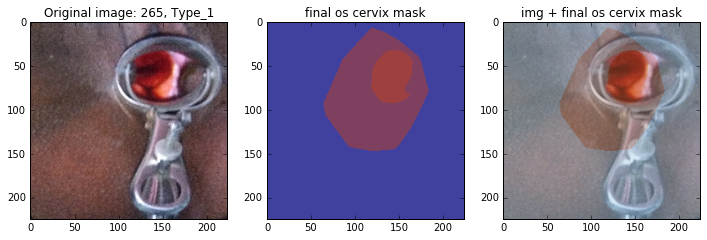

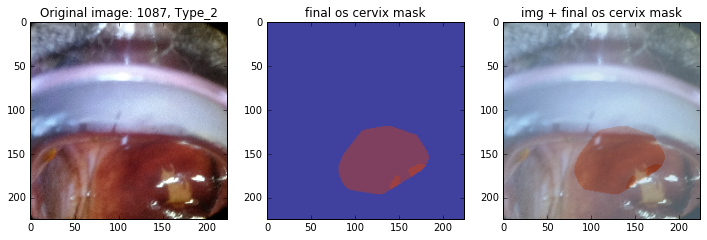

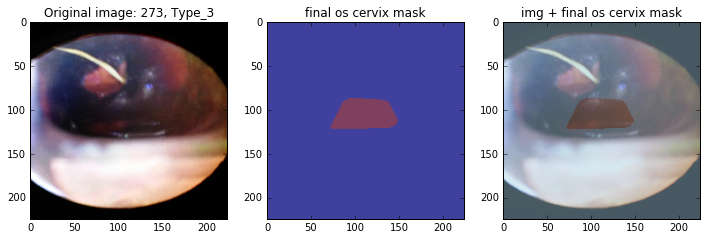

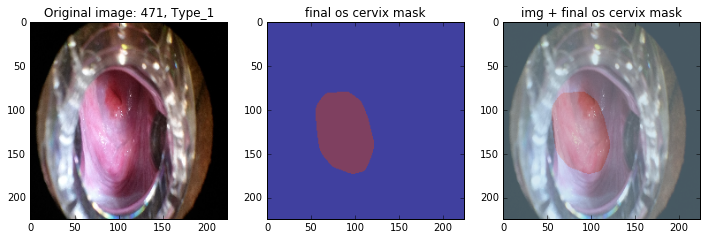

In [58]:
id_type_list = [('1013', 'Type_1'), 
                ('1061', 'Type_1'), 
                ('601', 'Type_2'), 
                ('633', 'Type_2'), 
                ('565', 'Type_3'), 
                ('141', 'Test'),
                ('265', 'Type_1'),
                ('1087', 'Type_2'),  
                ('273', 'Type_3'),                  
                ('471', 'Type_1')]

for image_id, image_type in id_type_list:
    img = get_image_data(image_id, image_type)
    final_os_cervix_mask = get_image_data(image_id + "_" + image_type, 'os_cervix_label')
    
    img = cv2.resize(img, dsize=final_os_cervix_mask.shape[:2][::-1], interpolation=cv2.INTER_NEAREST)
    
    plt_st(12, 6)
    plt.subplot(131)
    plt.imshow(img)
    plt.title("Original image: %s, %s" % (image_id, image_type))
    plt.subplot(132)
    plt.imshow(final_os_cervix_mask[:,:,0], alpha=0.5, cmap='jet')    
    plt.imshow(final_os_cervix_mask[:,:,1], alpha=0.5, cmap='jet')
    plt.title("final os cervix mask")
    plt.subplot(133)
    plt.imshow(img)
    plt.imshow(final_os_cervix_mask[:,:,0], alpha=0.25, cmap='Paired')
    plt.imshow(final_os_cervix_mask[:,:,1], alpha=0.25, cmap='Paired')
    plt.title("img + final os cervix mask")


### Create masked images of os and cervix of 244x244 size

In [59]:
import numpy as np
from postprocessing_utils import crop_to_mask

In [ ]:
counter = 1
ll = len(all_trainval_id_type_list)

no_os_detected_id_type_list = []
no_cervix_detected_id_type_list = []

for image_id, image_type in all_trainval_id_type_list:
    print('-- %i / %i : %s, %s' % (counter, ll, image_id, image_type))   

    img = get_image_data(image_id, image_type)
    os_cervix = get_image_data(image_id + "_" + image_type, "os_cervix_label")
    os_cervix = cv2.resize(os_cervix, dsize=img.shape[:2][::-1], interpolation=cv2.INTER_NEAREST)

    cervix_mask = os_cervix[:, :, 1]
    if np.sum(cervix_mask) > 0:
        img_cervix = crop_to_mask(img, cervix_mask)
        img_cervix = cv2.resize(img_cervix, dsize=(224, 224), interpolation=cv2.INTER_NEAREST)
        imwrite(img_cervix, image_id, image_type + '_cervix')
    else:
        print("No cervix detected on the image: %s, %s" % (image_id, image_type))
        no_cervix_detected_id_type_list.append((image_id, image_type))
        
    os_mask = os_cervix[:, :, 0]
    if np.sum(os_mask) > 0:
        img_os = crop_to_mask(img, os_mask)
        img_os = cv2.resize(img_os, dsize=(224, 224), interpolation=cv2.INTER_NEAREST)        
        imwrite(img_os, image_id, image_type + '_os')
    else:
        # Write cervix instead of os
        print("No os detected on the image: %s, %s" % (image_id, image_type))
        imwrite(img_cervix, image_id, image_type + '_os')
        no_os_detected_id_type_list.append((image_id, image_type))
        
    counter += 1

-- 1 / 1992 : 0, Type_1
-- 2 / 1992 : 10, Type_1
-- 3 / 1992 : 1013, Type_1
-- 4 / 1992 : 1014, Type_1
-- 5 / 1992 : 1019, Type_1
-- 6 / 1992 : 102, Type_1
-- 7 / 1992 : 1023, Type_1
-- 8 / 1992 : 1024, Type_1
-- 9 / 1992 : 1026, Type_1
-- 10 / 1992 : 1027, Type_1
-- 11 / 1992 : 1033, Type_1
-- 12 / 1992 : 104, Type_1
-- 13 / 1992 : 1040, Type_1
-- 14 / 1992 : 1056, Type_1
-- 15 / 1992 : 1059, Type_1
-- 16 / 1992 : 1061, Type_1
-- 17 / 1992 : 1070, Type_1
-- 18 / 1992 : 1071, Type_1
-- 19 / 1992 : 1077, Type_1
-- 20 / 1992 : 1079, Type_1
-- 21 / 1992 : 109, Type_1
-- 22 / 1992 : 1093, Type_1
-- 23 / 1992 : 1100, Type_1
-- 24 / 1992 : 1105, Type_1
-- 25 / 1992 : 1123, Type_1
-- 26 / 1992 : 1131, Type_1
-- 27 / 1992 : 1134, Type_1
-- 28 / 1992 : 1136, Type_1
-- 29 / 1992 : 1139, Type_1
-- 30 / 1992 : 1154, Type_1
-- 31 / 1992 : 1161, Type_1
-- 32 / 1992 : 1168, Type_1
-- 33 / 1992 : 1174, Type_1
-- 34 / 1992 : 1179, Type_1
-- 35 / 1992 : 1190, Type_1
-- 36 / 1992 : 1194, Type_1
-- 37 / 1

In [ ]:
no_cervix_detected_id_type_list

In [ ]:
no_os_detected_id_type_list

## Display all generated training data

In [43]:
tile_size = (224, 224)
n = 15

complete_images = []
for k, type_ids in enumerate([type_1_ids, type_2_ids, type_3_ids]):
    m = int(np.ceil(len(type_ids) * 1.0 / n))
    complete_image = np.zeros((m*(tile_size[0]+2), n*(tile_size[1]+2), 3), dtype=np.uint8)
    train_ids = sorted(type_ids)
    counter = 0
    for i in range(m):
        ys = i*(tile_size[1] + 2)
        ye = ys + tile_size[1]
        for j in range(n):
            xs = j*(tile_size[0] + 2)
            xe = xs + tile_size[0]
            if counter == len(train_ids):
                break
            image_id = train_ids[counter]; counter+=1
            if image_id == '1339' and 'Type_1' == 'Type_%i' % (k+1):
                continue
            img = get_image_data(image_id, 'Type_%i_os' % (k+1))
            img = cv2.resize(img, dsize=tile_size)
            img = cv2.putText(img, image_id, (5,img.shape[0] - 5), cv2.FONT_HERSHEY_SIMPLEX, 2.0, (255, 255, 255), thickness=3)
            complete_image[ys:ye, xs:xe, :] = img[:,:,:]
        if counter == len(train_ids):
            break
    complete_images.append(complete_image)           

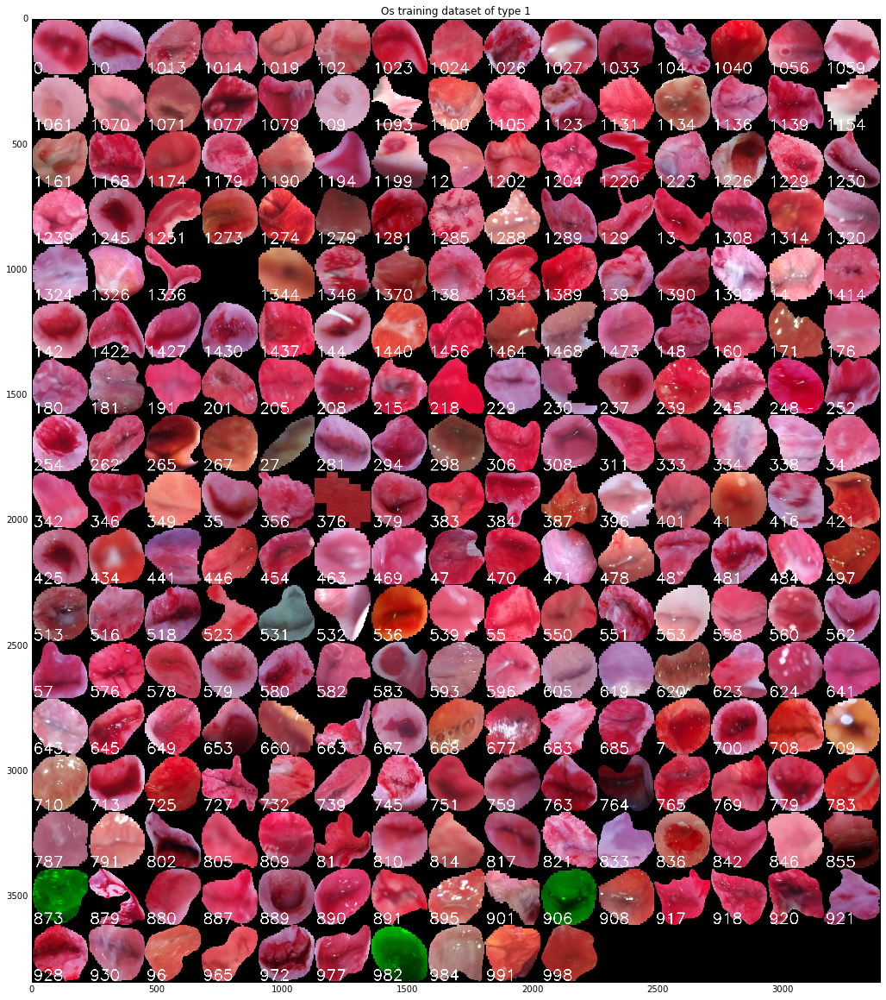

In [44]:
plt_st(20, 20)
plt.imshow(complete_images[0])
plt.title("Os training dataset of type %i" % (1))

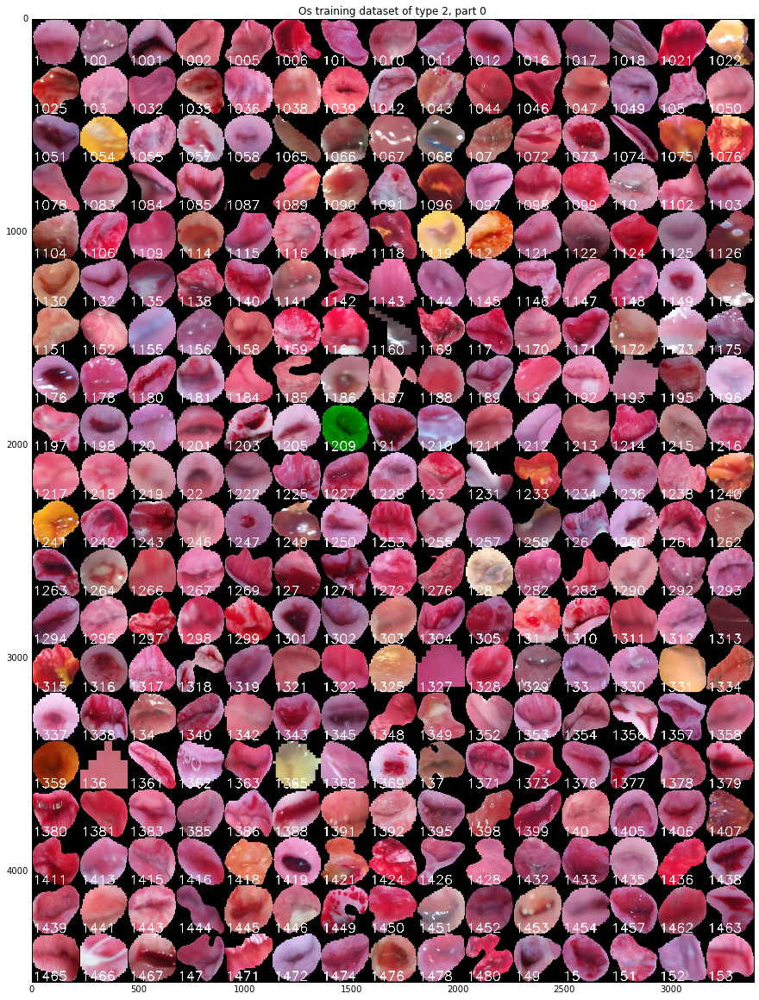

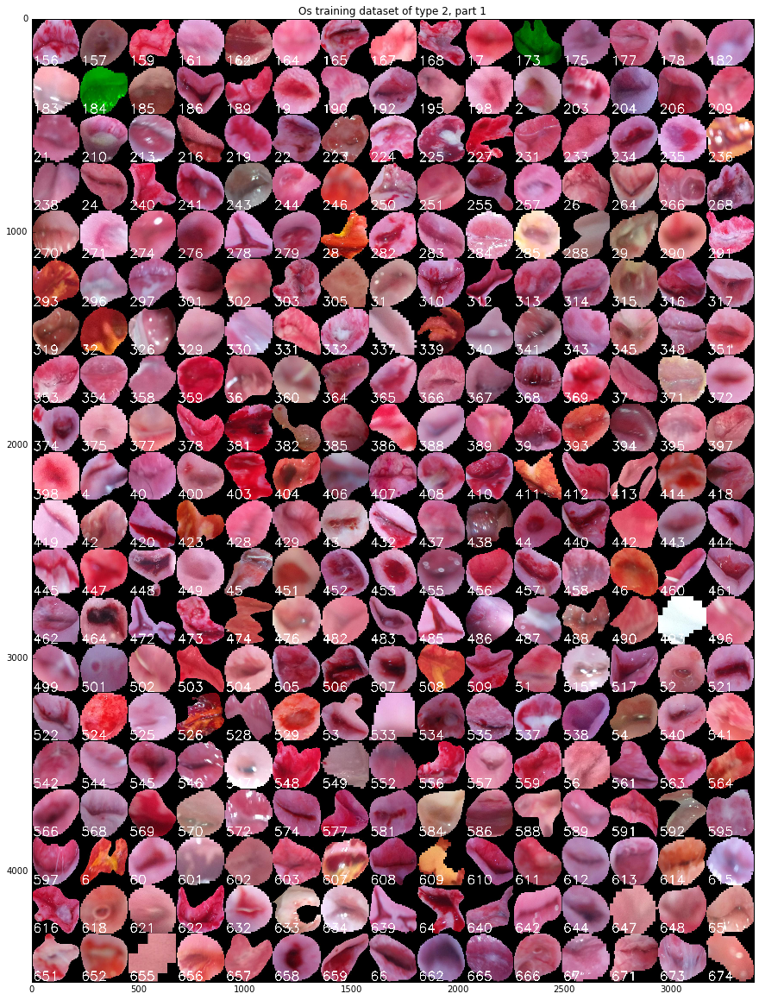

In [45]:
index = 1
m = complete_images[index].shape[0] / (tile_size[0] + 2)
n = int(np.ceil(m / 20))
for i in range(n):
    plt_st(20, 20)
    ys = i*(tile_size[0] + 2)*20
    ye = min((i+1)*(tile_size[0] + 2)*20, complete_images[index].shape[0])
    plt.imshow(complete_images[index][ys:ye,:,:])
    plt.title("Os training dataset of type %i, part %i" % (index + 1, i))

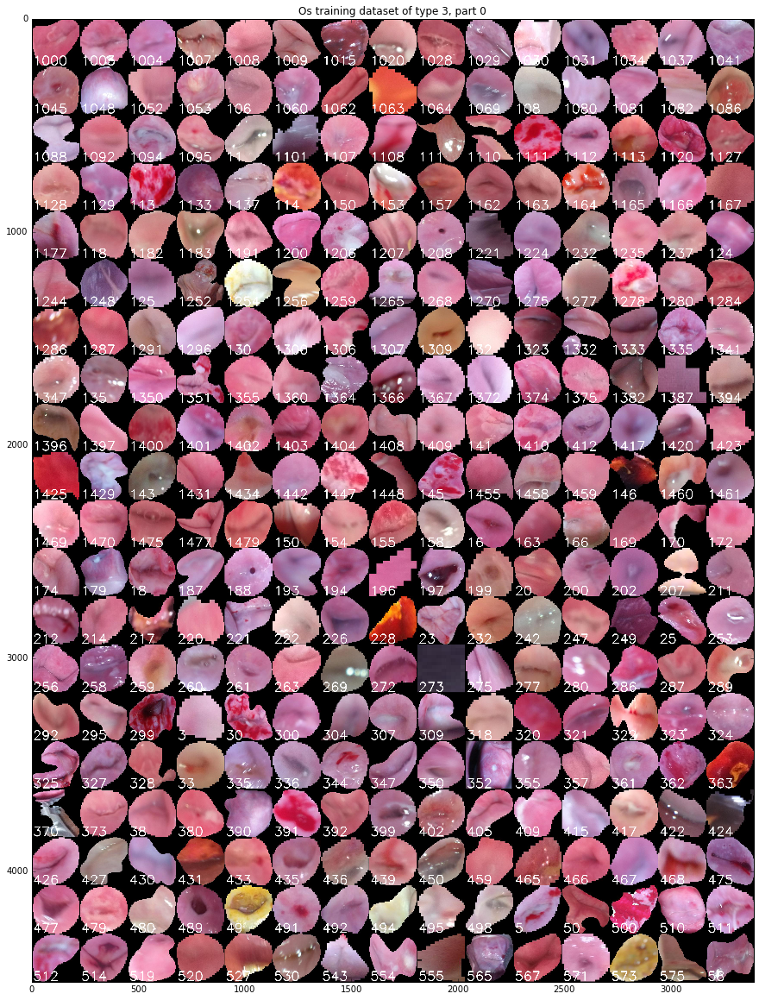

In [46]:
index = 2
m = complete_images[index].shape[0] / (tile_size[0] + 2)
n = int(np.ceil(m / 20))
for i in range(n):
    plt_st(20, 20)
    ys = i*(tile_size[0] + 2)*20
    ye = min((i+1)*(tile_size[0] + 2)*20, complete_images[index].shape[0])
    plt.imshow(complete_images[index][ys:ye,:,:])
    plt.title("Os training dataset of type %i, part %i" % (index + 1, i))

In [49]:
tile_size = (224, 224)
n = 15

complete_images = []
for k, type_ids in enumerate([type_1_ids, type_2_ids, type_3_ids]):
    m = int(np.ceil(len(type_ids) * 1.0 / n))
    complete_image = np.zeros((m*(tile_size[0]+2), n*(tile_size[1]+2), 3), dtype=np.uint8)
    train_ids = sorted(type_ids)
    counter = 0
    for i in range(m):
        ys = i*(tile_size[1] + 2)
        ye = ys + tile_size[1]
        for j in range(n):
            xs = j*(tile_size[0] + 2)
            xe = xs + tile_size[0]
            if counter == len(train_ids):
                break
            image_id = train_ids[counter]; counter+=1
            if image_id == '1339' and 'Type_1' == 'Type_%i' % (k+1):
                continue            
            img = get_image_data(image_id, 'Type_%i_cervix' % (k+1))
            img = cv2.resize(img, dsize=tile_size)
            img = cv2.putText(img, image_id, (5,img.shape[0] - 5), cv2.FONT_HERSHEY_SIMPLEX, 2.0, (255, 255, 255), thickness=3)
            complete_image[ys:ye, xs:xe, :] = img[:,:,:]
        if counter == len(train_ids):
            break
    complete_images.append(complete_image)           

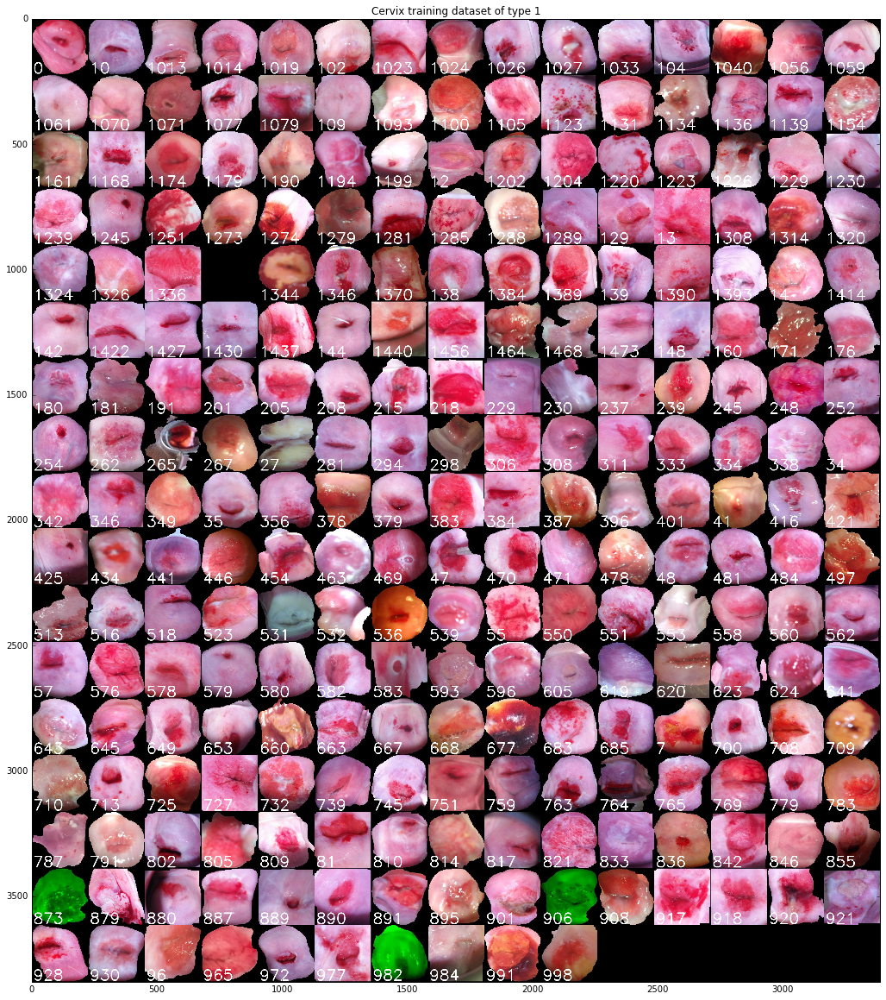

In [50]:
plt_st(20, 20)
plt.imshow(complete_images[0])
plt.title("Cervix training dataset of type %i" % (1))

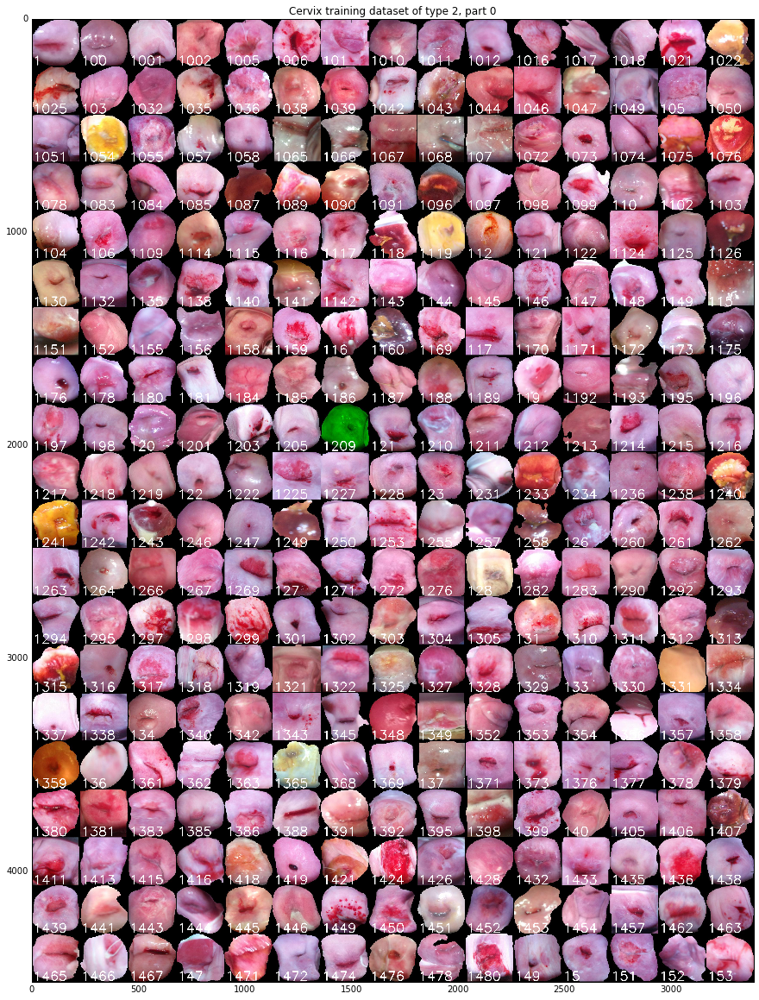

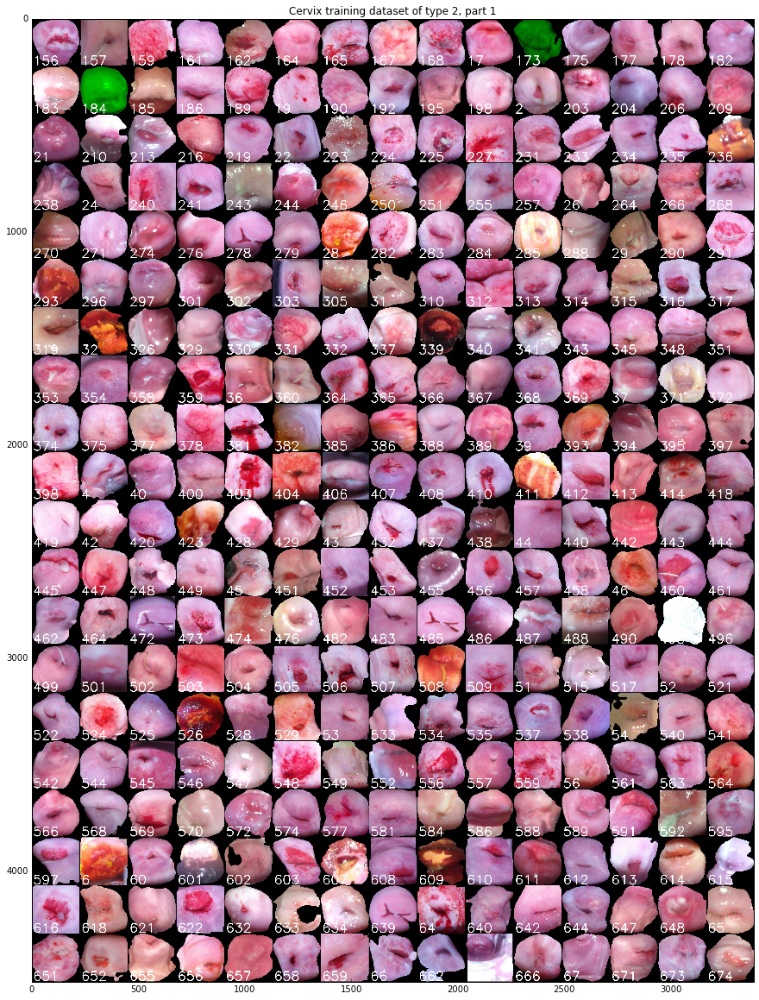

In [51]:
index = 1
m = complete_images[index].shape[0] / (tile_size[0] + 2)
n = int(np.ceil(m / 20))
for i in range(n):
    plt_st(20, 20)
    ys = i*(tile_size[0] + 2)*20
    ye = min((i+1)*(tile_size[0] + 2)*20, complete_images[index].shape[0])
    plt.imshow(complete_images[index][ys:ye,:,:])
    plt.title("Cervix training dataset of type %i, part %i" % (index + 1, i))

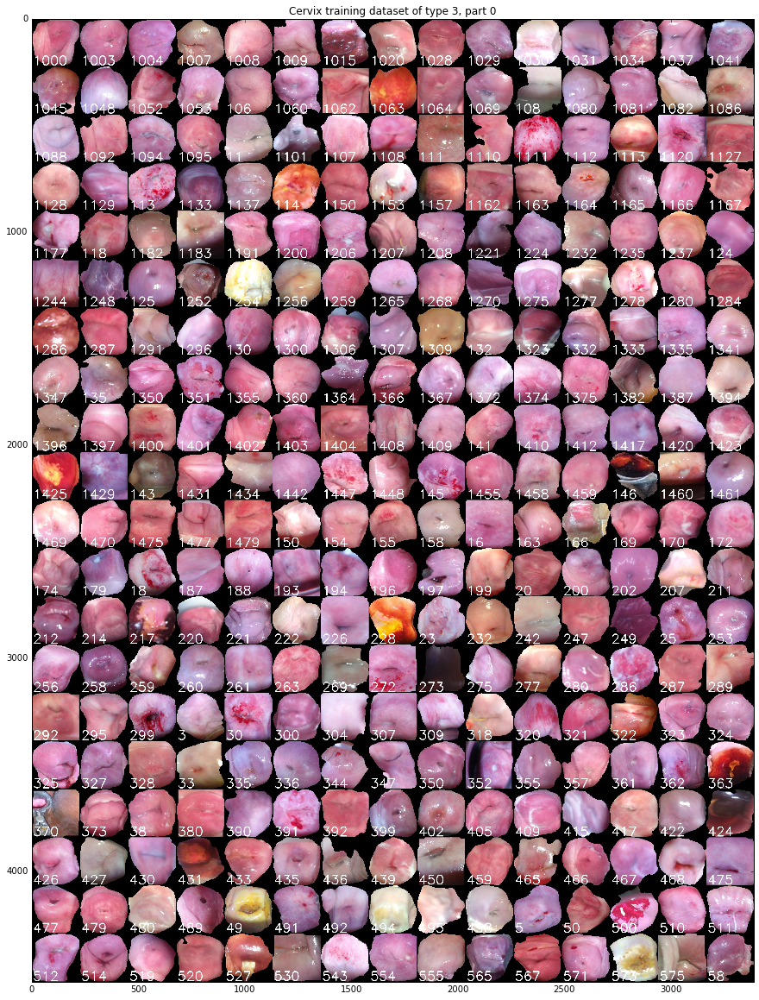

In [52]:
index = 2
m = complete_images[index].shape[0] / (tile_size[0] + 2)
n = int(np.ceil(m / 20))
for i in range(n):
    plt_st(20, 20)
    ys = i*(tile_size[0] + 2)*20
    ye = min((i+1)*(tile_size[0] + 2)*20, complete_images[index].shape[0])
    plt.imshow(complete_images[index][ys:ye,:,:])
    plt.title("Cervix training dataset of type %i, part %i" % (index + 1, i))